<a href="https://colab.research.google.com/github/felpa16/Github_Workshop/blob/main/TP1_Vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
root_path = '/content/drive/MyDrive/TP1_vision_imgs'

Mounted at /content/drive


In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
from tqdm import tqdm


In [ ]:
#Define paths for images
path_img_left = root_path + '/cuadro_0.jpg'
path_img_center = root_path + '/cuadro_1.jpg'
path_img_right = root_path + '/cuadro_2.jpg'

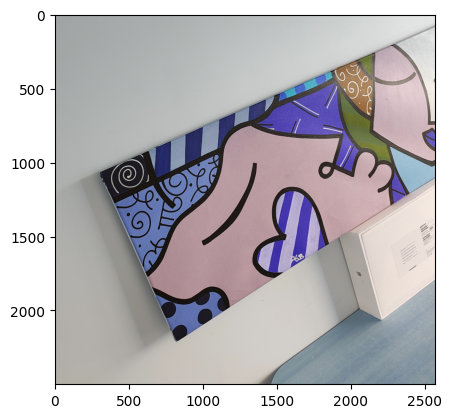

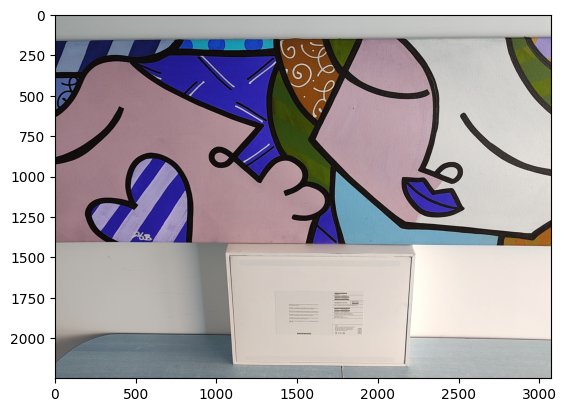

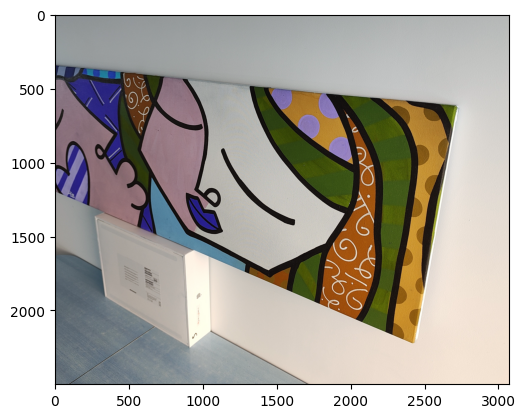

In [ ]:
# Create cropped versions of original images to extract relevant parts
image_left = cv2.imread(path_img_left)

# Crop original image to only include relevant sections
cropped_left = image_left[1000:3500, 500:]

# Save the cropped image
cv2.imwrite(root_path +'/left_cropped.jpg', cropped_left)

# Repeat for other images
image_center = cv2.imread(path_img_center)
cropped_center = image_center[1500:3750, :]
cv2.imwrite(root_path +'/center_cropped.jpg', cropped_center)

image_right = cv2.imread(path_img_right)
cropped_right = image_right[1000:3500, :]
cv2.imwrite(root_path +'/right_cropped.jpg', cropped_right)

# Display the images
plt.imshow(cv2.imread(root_path+'/left_cropped.jpg'))
plt.show()
plt.imshow(cv2.imread(root_path+'/center_cropped.jpg'))
plt.show()
plt.imshow(cv2.imread(root_path+'/right_cropped.jpg'))
plt.show()

# Trabajo Sobre Mitad Izquierda del Cuadro

## Encontrar Keypoints y Descriptores


In [ ]:
# Guardar las imágenes en variables
img_lft = cv2.imread(root_path+'/left_cropped.jpg', cv2.IMREAD_GRAYSCALE)
img_ctr = cv2.imread(root_path+'/center_cropped.jpg', cv2.IMREAD_GRAYSCALE)

In [ ]:
#Inicializar SIFT para encontrar desctiptores y keypoints
algo = cv2.SIFT_create()

In [ ]:
# Usamos SIFT para encontrar keypoints y descriptores para nuestras imagenes

#Izquierda
kp_izquierda, desc_izquierda = algo.detectAndCompute(img_lft, None)
print("kps cuadro izquierda", len(kp_izquierda), "descriptores cuadro izquierda", len(desc_izquierda))

# Centro
kp_centro, desc_centro = algo.detectAndCompute(img_ctr, None)
print("kps cuadro centro", len(kp_centro), "descriptores cuadro centro", len(desc_centro))


kps cuadro izquierda 13368 descriptores cuadro izquierda 13368
kps cuadro centro 12178 descriptores cuadro centro 12178


## Filtrar Keypoints con ANMS

In [ ]:
# Function para filtar máximos puntos de respuesta en un determinado radio

def max_local_kp(keypoints, descriptors, radius):
    filtered_keypoints = []
    filtered_descriptors = []

    # Loop through keypoints
    for i, kp in tqdm(enumerate(keypoints), total=len(keypoints), desc="Processing keypoints", unit="kpts"):
        local_max = True
        for j, kp2 in enumerate(keypoints):
            if i == j:
                continue
            # Calculate distance between keypoints
            dist = np.linalg.norm(np.array(kp.pt) - np.array(kp2.pt))
            # Check if the current keypoint is not the local maximum
            if (dist < radius) and (kp.response < kp2.response):
                local_max = False
                break

        # If the keypoint is a local maximum, store it and its corresponding descriptor
        if local_max:
            filtered_keypoints.append(kp)
            filtered_descriptors.append(descriptors[i])

    # Convert the lists back to arrays with the same format as the input
    filtered_keypoints = np.array(filtered_keypoints, dtype=object)
    filtered_descriptors = np.array(filtered_descriptors)

    return filtered_keypoints, filtered_descriptors

# ANMS function to keep n optimal keypoints

def anms(keypoints, descriptors, n):
    if n > len(keypoints):
        print("ERROR: There are fewer keypoints than N")
        return

    chosen_kpts_r = []  # List to store keypoints, descriptors, and their r-values

    # Loop through each keypoint and calculate its ANMS score (r-value)
    for i in tqdm(range(len(keypoints)), desc="Processing keypoints for ANMS", unit="kpts"):
        r = np.inf
        response = keypoints[i].response

        for j in range(len(keypoints)):
            if i == j:
                continue

            # Check if the other keypoint has a higher response
            if keypoints[j].response > response:
                # Calculate squared distance between the two keypoints
                sd = np.linalg.norm(np.array(keypoints[i].pt) - np.array(keypoints[j].pt)) ** 2
                if sd < r:
                    r = sd

        # Append the keypoint, descriptor, and the computed r-value
        chosen_kpts_r.append((keypoints[i], descriptors[i], r))

    # Sort keypoints by the r-value and select the top N keypoints
    if n > len(chosen_kpts_r):
        n = len(chosen_kpts_r)-1
    chosen_kpts_r_sorted = sorted(chosen_kpts_r, key=lambda x: x[2], reverse=True)[:n]

    # Separate keypoints and descriptors into two lists
    filtered_keypoints = [kp[0] for kp in chosen_kpts_r_sorted]
    filtered_descriptors = [kp[1] for kp in chosen_kpts_r_sorted]

    # Convert lists to numpy arrays with the same format as the input
    filtered_keypoints = np.array(filtered_keypoints, dtype=object)
    filtered_descriptors = np.array(filtered_descriptors)

    return filtered_keypoints, filtered_descriptors

Processing keypoints: 100%|██████████| 13368/13368 [14:09<00:00, 15.74kpts/s]


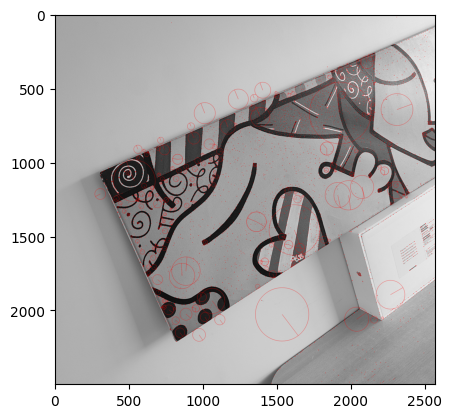

Keypoints de cuadro izquierda luego de filltrado por max local:  4243


In [ ]:
# Filtrar kp máximos locales de la imagen de la izquierda

kp_izq, desc_izq  = max_local_kp(kp_izquierda, desc_izquierda, 10)

# Plotear imagen con los kp máximos restantes

kp_cuadro_izq_img = cv2.cvtColor(img_lft, cv2.COLOR_GRAY2BGR)
kp_cuadro_izq_img = cv2.drawKeypoints(
    kp_cuadro_izq_img,
    kp_izq,
    0, (255, 0, 0),
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)
plt.imshow(kp_cuadro_izq_img)
plt.show()
print("Keypoints de cuadro izquierda luego de filltrado por max local: ", len(kp_izq))

In [ ]:
# Filtrar kp máximos locales de la imagen del centro

kp_ctr, desc_ctr  = max_local_kp(kp_centro, desc_centro, 10)
print("Keypoints de cuadro centro luego de filltrado por max local: ", len(kp_ctr))

Processing keypoints: 100%|██████████| 12178/12178 [12:11<00:00, 16.64kpts/s]

Keypoints de cuadro centro luego de filltrado por max local:  5039


Processing keypoints for ANMS: 100%|██████████| 4243/4243 [01:14<00:00, 56.81kpts/s]


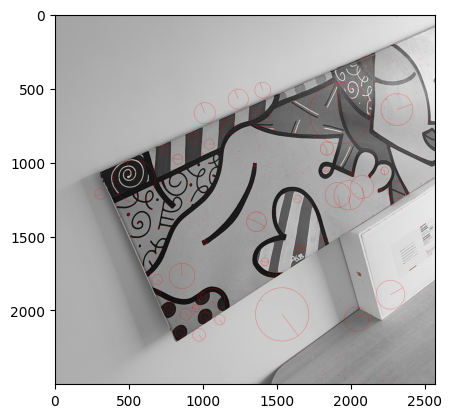

Keypoints de cuadro izquierda luego de filltrado por max local:  600


Processing keypoints for ANMS: 100%|██████████| 5039/5039 [01:46<00:00, 47.13kpts/s]


In [ ]:
# Perform ANMS over filtered keypoints

# Cuadro izquierda
kp_izq, desc_izq  = anms(kp_izq, desc_izq, 600)

# Plotear kp restantes luego de ANMS

kp_cuadro_izq_img = cv2.cvtColor(img_lft, cv2.COLOR_GRAY2BGR)
kp_cuadro_izq_img = cv2.drawKeypoints(
    kp_cuadro_izq_img,
    kp_izq,
    0, (255, 0, 0),
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)
plt.imshow(kp_cuadro_izq_img)
plt.show()

print("Keypoints de cuadro izquierda luego de filltrado por max local: ", len(kp_izq))

# Cuadro centro
kp_ctr, desc_ctr  = anms(kp_ctr, desc_ctr, 600)



## Matching

In [ ]:
# Función para hacer Brute Force Matching con Lowe Ratio filtering

def bf_knn_lowe_matcher(des1, des2, k=2, threshold=0.75):
    # Create a BFMatcher object
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)

    # Perform k-nearest neighbors matching
    matches = bf.knnMatch(des1, des2, k=k)

    # Nos quedamos con matches cuyo segundo mejor match está lejos
    matchesMask = [[0, 0] for i in range(len(matches))]
    for i, (m, n) in enumerate(matches):
        if m.distance < threshold * n.distance:
            matchesMask[i] = [1, 0]

    return matches, matchesMask

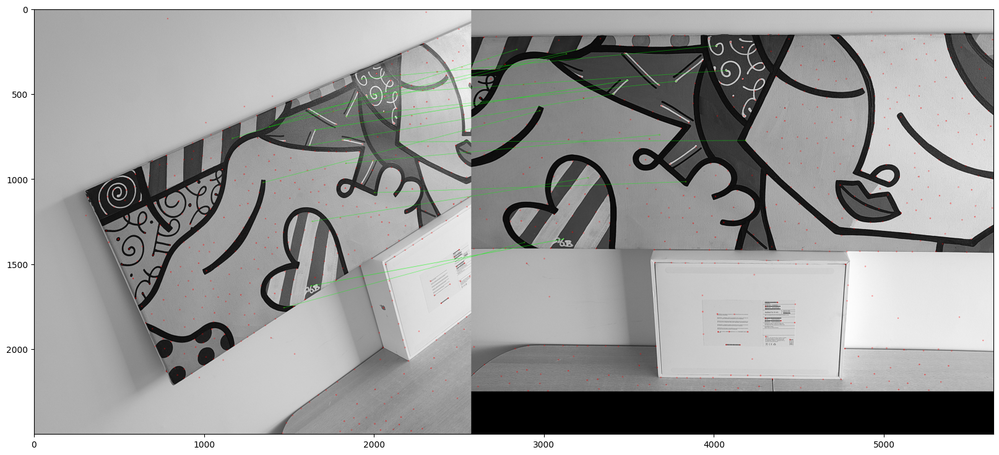

Matches encontrados:  17


In [ ]:
# Encontrar Matches entre imagenes del lado izquierdo y centro

matches_i, matchesMask_i = bf_knn_lowe_matcher(desc_izq, desc_ctr, threshold=0.5)

# Dibuja sólo buenos matches al filtrar con la máscara
draw_params = dict(matchColor=(0, 255, 0),
                   singlePointColor=(255, 0, 0),
                   matchesMask=matchesMask_i,
                   flags=cv2.DrawMatchesFlags_DEFAULT)


res_img = cv2.drawMatchesKnn(
    img_lft, kp_izq, img_ctr, kp_ctr, matches_i, None, **draw_params
)

plt.figure(figsize=(20, 16))
plt.imshow(res_img)
plt.show()

# Aplicar máscara a matches para quedarme solo con los buenos
matches_i = [m[0] for m, mask in zip(matches_i, matchesMask_i) if mask[0] == 1]
print("Matches encontrados: ",len(matches_i))

## Estimación de Homografías

### DLT Manual Para Estimación de Homografía

---



In [ ]:
#Establecemos pares de correspondencias entre puntos en las dos imagenes de forma manual
# Coordenadas izquierda

# Punta nariz color 1919 x 838y
# Punta nariz negra 1946 x 810y
# Interseccion lineas horizontal y cabeza izquierda 1117 901
# punta más a la derecha de la pestaña 1361 1007
# culo del corazon 1514 1494
# union izquierda corazon y borde inf cuadro 1484 1783
# union mentton con cuadro lado externo linea negra 2288 1279
# lado interno pestaña mujer arriba 2159 421

# Coordenadas centro

# Punta nariz color 1238   703
# Punta nariz negra 1294. 687
# Interseccion lineas horizontal y cabeza izquierda 169. 358
# punta más a la derecha de la pestaña 429. 585
# culo del corazon 455 1153
# union izquierda corazon y borde inf cuadro 316  1409
# union mentton con cuadro lado externo linea negra 1593  1418
# lado interno pestaña mujer arriba 1813  350




In [ ]:

# Función para obtener homografía a partir de correspondencias de forma manual

def dlt(coord_1, coord_2):
    # Construct matrix A and vector b
    A = []
    for i in range(4):
        x, y = coord_1[i]
        x_prima, y_prima = coord_2[i]
        A.append([-x, -y, -1, 0, 0, 0, x * x_prima, y * x_prima, x_prima])
        A.append([0, 0, 0, -x, -y, -1, x * y_prima, y * y_prima, y_prima])

    A = np.array(A)

    # Perform SVD on A
    U, S, Vt = np.linalg.svd(A)

    # Get the singular vector corresponding to the smallest singular value (last row of Vt)
    H = Vt[-1, :]

    # Reshape the 9 elements vector H into a 3x3 homography matrix
    H = H.reshape(3, 3)

    # Normalize H to get 1 in the bottom right corner
    H = H / H[2, 2]

    return H

In [ ]:
# Funciones para aplicar homografía a imagen de forma manual

def apply_homography_to_rgb_image(image, H):
    # Get image dimensions
    height, width, channels = image.shape
    print(image.shape)

    # Initialize an empty output image (all black)
    output_image = np.zeros_like(image)

    # Inverse of H (to do inverse mapping)
    H_inv = np.linalg.inv(H)

    for i in range(height):
        for j in range(width):
            # Apply inverse homography to the pixel (i, j)
            source_coords = np.array([j, i, 1])  # (x, y, 1)
            mapped_coords = np.dot(H_inv, source_coords)

            # Normalize homogeneous coordinates
            mapped_coords /= mapped_coords[2]
            x_mapped, y_mapped = mapped_coords[0], mapped_coords[1]

            # Check if the mapped coordinates are within bounds of the original image
            if 0 <= x_mapped < width and 0 <= y_mapped < height:
                # Use nearest neighbor or interpolation (bilinear would be better)
                x_mapped_int = int(round(x_mapped))-1
                y_mapped_int = int(round(y_mapped))-1

                # Assign the color of the nearest pixel in the original image
                output_image[i, j] = image[y_mapped_int, x_mapped_int]

    return output_image

In [ ]:
# Seleccionamos 4 correspondencias (Son el mínimo necesario)

points_left = np.array([
    # [1919, 838],
    # [1946, 810],
    [1117, 901],
    # [1361, 1007],
    # [1514, 1494],
    [1484, 1783],
    [2288, 1279],
    [2159, 421]
])

points_center = np.array([
    # [1238, 703],
    # [1294, 687],
    [169, 358],
    # [429, 585],
    # [455, 1153],
    [316, 1409],
    [1593, 1418],
    [1813, 350]
])

#Obtenemos homografía a partir de correspondencias

H = dlt(points_left, points_center)
print(H)

[[ 1.05261386e+00 -2.79499154e-01 -7.67946187e+02]
 [ 3.82708704e-01  9.61409461e-01 -9.63265104e+02]
 [-1.21573351e-04  6.53089478e-05  1.00000000e+00]]


In [ ]:
# Leemos imagenes a color
img_lft_color = cv2.imread(root_path+'/left_cropped.jpg', cv2.IMREAD_COLOR)
img_ctr_color = cv2.imread(root_path+'/center_cropped.jpg', cv2.IMREAD_COLOR)
img_rgt_color = cv2.imread(root_path+'/right_cropped.jpg', cv2.IMREAD_COLOR)


(2500, 2572, 3)


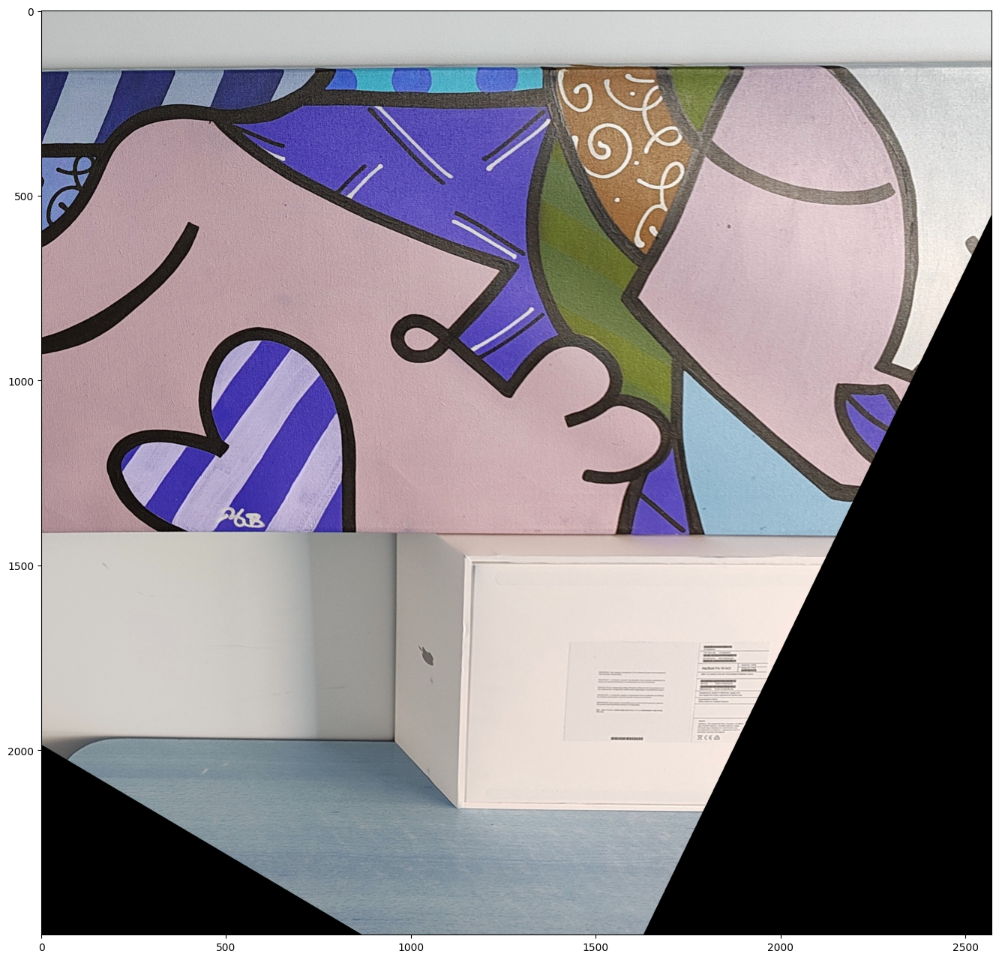

In [ ]:
# Aplicamos homografía a imagen de la izquierda para transformara a la perspectiva de la central

dst = apply_homography_to_rgb_image(img_lft_color, H)

# Mostramos imagen
plt.figure(figsize=(20, 16))
plt.imshow(dst)
plt.show()


In [ ]:
# Guardar imagen
# cv2.imwrite(root_path +'/left_transformed.jpg', dst)

### Estimación de Homografía usando OpenCV y RANSAC


In [ ]:
# Función para hallar homografía a partir de keypoints y matches aplicando RANSAC

def compute_homography(kp1, kp2, matches, ransac_threshold=5.0):
    # Extract the matched keypoints from the matches
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    # Compute the homography matrix using RANSAC to filter outliers
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, ransac_threshold)

    return H, mask

def warp_full_image(image, H, mp_left, mp_right):
    height, width = image.shape[:2]

    # Step 2: Compute the transformed coordinates of the corners of the image
    corners = np.array([
        [0, 0],           # Top-left
        [width, 0],       # Top-right
        [width, height],  # Bottom-right
        [0, height]       # Bottom-left
    ], dtype=np.float32)
    corners = np.array([corners])

    # Transform the corners using the homography matrix
    transformed_corners = cv2.perspectiveTransform(corners, H)[0]

    # Step 3: Find the bounding box of the transformed image
    [min_x, min_y] = np.int32(transformed_corners.min(axis=0))
    [max_x, max_y] = np.int32(transformed_corners.max(axis=0))

    # Calculate the size of the output image based on the transformed bounding box
    new_width = max_x - min_x
    new_height = max_y - min_y

    # Step 4: Adjust the translation part of the homography to account for negative offsets
    translation_matrix = np.array([[1, 0, -min_x],
                                   [0, 1, -min_y],
                                   [0, 0, 1]])

    H_translated = translation_matrix @ H  # Adjust homography to account for translation

    # Step 5: Warp the original image using the adjusted homography and new dimensions
    warped_image = cv2.warpPerspective(image, H_translated, (new_width, new_height))

    # Calculate shift between kp on right image and kp on transformed left image
    x , y = mp_left
    h_kp_left = np.array([x, y, 1])
    point_dst_homogeneous = np.dot(H_translated, h_kp_left)
    x_dst = point_dst_homogeneous[0] / point_dst_homogeneous[2]
    y_dst = point_dst_homogeneous[1] / point_dst_homogeneous[2]
    xr, yr = mp_right
    shift = np.array([np.abs(xr-x_dst), np.abs(yr-y_dst)])

    return warped_image, transformed_corners, shift

def get_matched_points(matches, mask, kp_izq, kp_ctr):
    # Filter matches using the mask
    masked_matches = [m for m, r in zip(matches, mask) if r[0] == 1]

    matched_pts_img1 = []
    matched_pts_img2 = []

    # Extract the coordinates of the matched points
    for i, match in enumerate(masked_matches):
        src_pt = kp_izq[match.queryIdx].pt
        dst_pt = kp_ctr[match.trainIdx].pt
        matched_pts_img1.append((src_pt[0], src_pt[1]))
        matched_pts_img2.append((dst_pt[0], dst_pt[1]))
        #print(f"Match {i}: Image1 ({src_pt[0]}, {src_pt[1]}) <-> Image2 ({dst_pt[0]}, {dst_pt[1]})")

    return matched_pts_img1, matched_pts_img2

In [ ]:
# Computar homografía para pasar de imagen izquierda a perspectiva de imagen central
H_i, mask_i = compute_homography(kp_izq, kp_ctr, matches_i)

# Obtener pares de puntos matcheados luego de RANSAC
matches_left_i, matches_right_i = get_matched_points(matches_i, mask_i, kp_izq, kp_ctr)


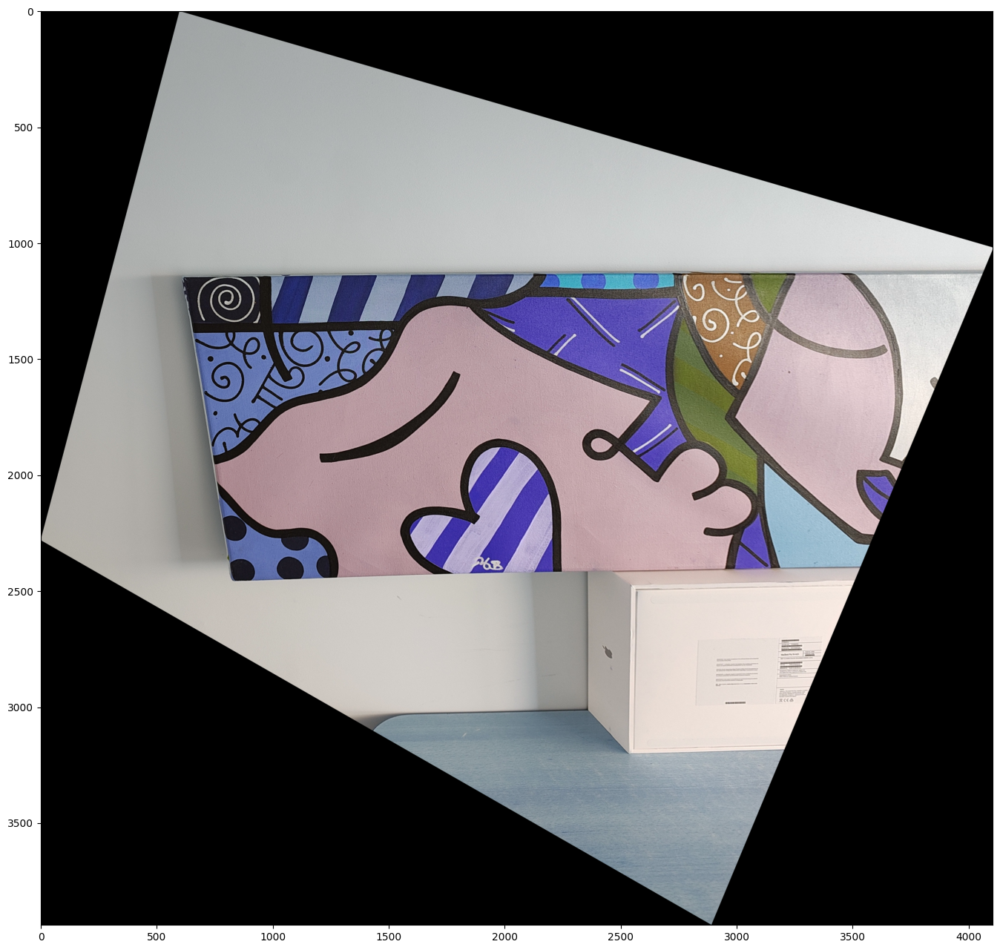

[1383.89425731  975.58505365]


In [ ]:
# Aplicar homografía y obtener shift entre puntos clave
warped_image_i, transformed_corners_i, match_shift_i = warp_full_image(img_lft_color, H_i, matches_left_i[0], matches_right_i[0])

# mostrar resultado
plt.figure(figsize=(20, 16))
plt.imshow(warped_image_i)
plt.show()
print(match_shift_i)

In [ ]:
# Guardar imagen
# cv2.imwrite(root_path +'/left_transformed_ransac.jpg', warped_image)

# Trabajo Sobre Mitad Derecha del Cuadro

kps cuadro derecha 25014 descriptores cuadro derecha 25014


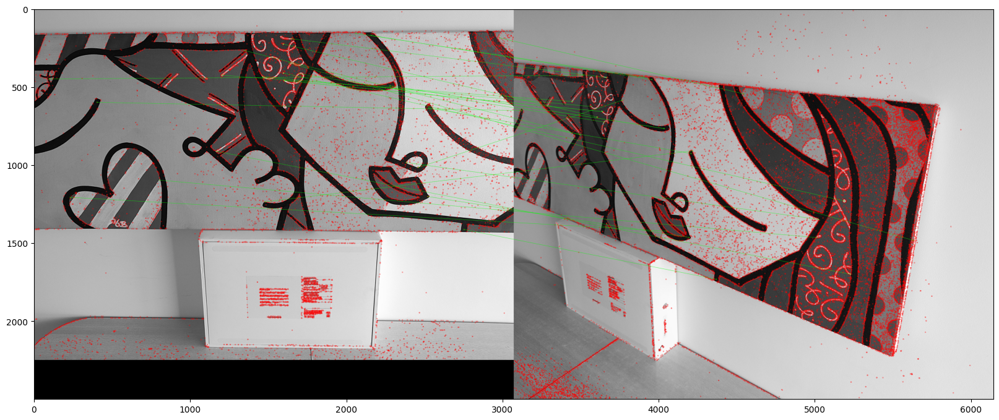

Matches encontrados:  26


In [ ]:
# Cargamos imagen derecha
img_der = cv2.imread(root_path +'/right_cropped.jpg', cv2.IMREAD_GRAYSCALE)
img_der_color = cv2.imread(root_path +'/right_cropped.jpg', cv2.IMREAD_COLOR)

# Sift para extraer keypoints y descriptores de la imagen derecha
algo_der = cv2.SIFT_create( contrastThreshold=0.03, edgeThreshold=20, sigma=1.4) # Sift optimizado para la imagen derecha

# Derecha
kp_der, desc_der = algo_der.detectAndCompute(img_der, None)
print("kps cuadro derecha", len(kp_der), "descriptores cuadro derecha", len(desc_der))

# BF matching con Lowe Ratio filtering para imagen central y derecha
# Para este matching se usaron los kp y descriptores de la imagen central y derecha obtenidos con SIFT, sin ANMS ni max local

matches_d, matchesMask_d = bf_knn_lowe_matcher(desc_centro, desc_der, threshold=0.6)

# Dibuja sólo buenos matches
draw_params = dict(matchColor=(0, 255, 0),
                   singlePointColor=(255, 0, 0),
                   matchesMask=matchesMask_d,
                   flags=cv2.DrawMatchesFlags_DEFAULT)


res_img = cv2.drawMatchesKnn(
    img_ctr, kp_centro, img_der, kp_der, matches_d, None, **draw_params
)

plt.figure(figsize=(20, 16))
plt.imshow(res_img)
plt.show()

# Aplicar máscara a matches para quedarme solo con los buenos
matches_d = [m[0] for m, mask in zip(matches_d, matchesMask_d) if mask[0] == 1]
print("Matches encontrados: ",len(matches_d))


Pares de puntos matcheados luego de RANSAC:  12


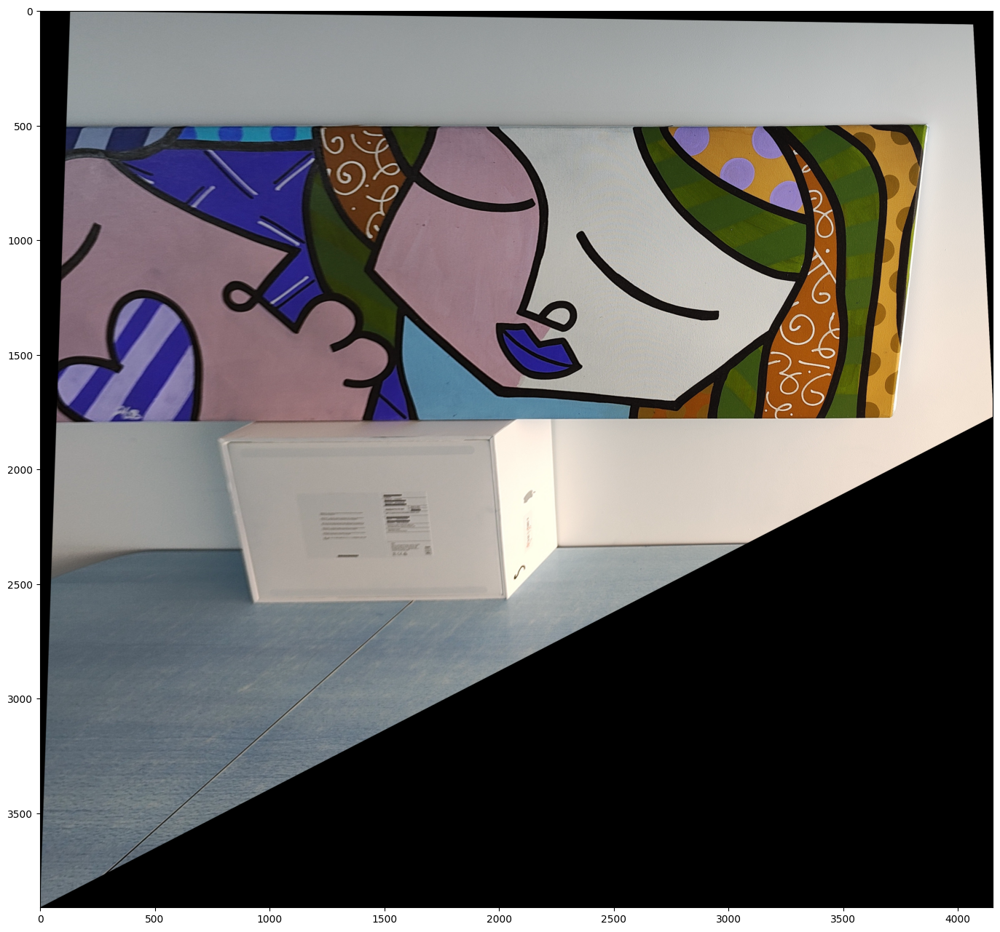

In [ ]:
# Computar homografía
H_d, mask_d= compute_homography(kp_centro, kp_der, matches_d, ransac_threshold = 10)

# Obtener pares de puntos matcheados luego de RANSAC
matches_left_d, matches_right_d = get_matched_points(matches_d, mask_d, kp_centro, kp_der)
print("Pares de puntos matcheados luego de RANSAC: ", len(matches_left_d))

# Calculamos la inversa de la homografía para transformar imagen de la derecha a la perspectiva de la del centro
H_inv = np.linalg.inv(H_d)

# Aplicar homografía inversa
warped_image_d, transformed_corners_d, match_shift_d = warp_full_image(img_rgt_color, H_inv, matches_right_d[0], matches_left_d[0])

# Mostrar resultado
plt.figure(figsize=(20, 16))
plt.imshow(warped_image_d)
plt.show()

In [ ]:
# Guardar imagen
# cv2.imwrite(root_path +'/right_transformed_ransac.jpg', warped_image_d)

In [ ]:
# print("Coordenadas puntos matcheados en imagen de la derecha: ")
# print(matches_right_d[0])
# print("Coordenadas puntos matcheados en imagen de la central: ")
# print(matches_left_d[0])

# Blendear Imagenes Transformadas Para Crear Panorámica

In [ ]:
# Función para blendear 2 imagenes en una sola

def overlap_images(image_left_warped, image_center):
    # Get dimensions of both images
    h_warped, w_warped = image_left_warped.shape[:2]
    h_center, w_center = image_center.shape[:2]

    # Create a canvas large enough to hold both images
    canvas_width = max(w_warped, w_center)
    canvas_height = max(h_warped, h_center)

    # Initialize a blank canvas (black background)
    canvas = np.zeros((canvas_height, canvas_width, 3), dtype=np.uint8)

    # Place the center image on the canvas
    canvas[:h_center, :w_center] = image_center

    #  Overlay the warped left image on the same canvas
    overlap_region = canvas[:h_warped, :w_warped]

    # Simple overlap
    canvas[:h_warped, :w_warped] = np.where(image_left_warped > 0, image_left_warped, overlap_region)

    # Blending overlap
    # alpha = 0.2  # Blend factor
    # canvas[:h_warped, :w_warped] = cv2.addWeighted(overlap_region, alpha, image_left_warped, 1 - alpha, 0)

    return canvas

# Función para trasladar una imagen y rellenar con 0

def translate_image(image, tx, ty):
  height, width = image.shape[:2]

  # Si la traslación es negativa, necesitamos ajustar las coordenadas
  if tx < 0:
      offset_x = -tx  # Cuánto espacio necesitamos a la izquierda
  else:
      offset_x = 0

  if ty < 0:
      offset_y = -ty  # Cuánto espacio necesitamos arriba
  else:
      offset_y = 0

  # Calcular nuevas dimensiones del lienzo
  new_width = width + abs(tx)
  new_height = height + abs(ty)

  # Crear matriz de traslación ajustada para el desplazamiento
  translation_matrix = np.float32([[1, 0, tx + offset_x],
                                    [0, 1, ty + offset_y]])

  # Aplicar la traslación y crear el nuevo lienzo
  translated_image = cv2.warpAffine(image, translation_matrix, (new_width, new_height), borderMode=cv2.BORDER_CONSTANT, borderValue=(0, 0, 0))

  return translated_image


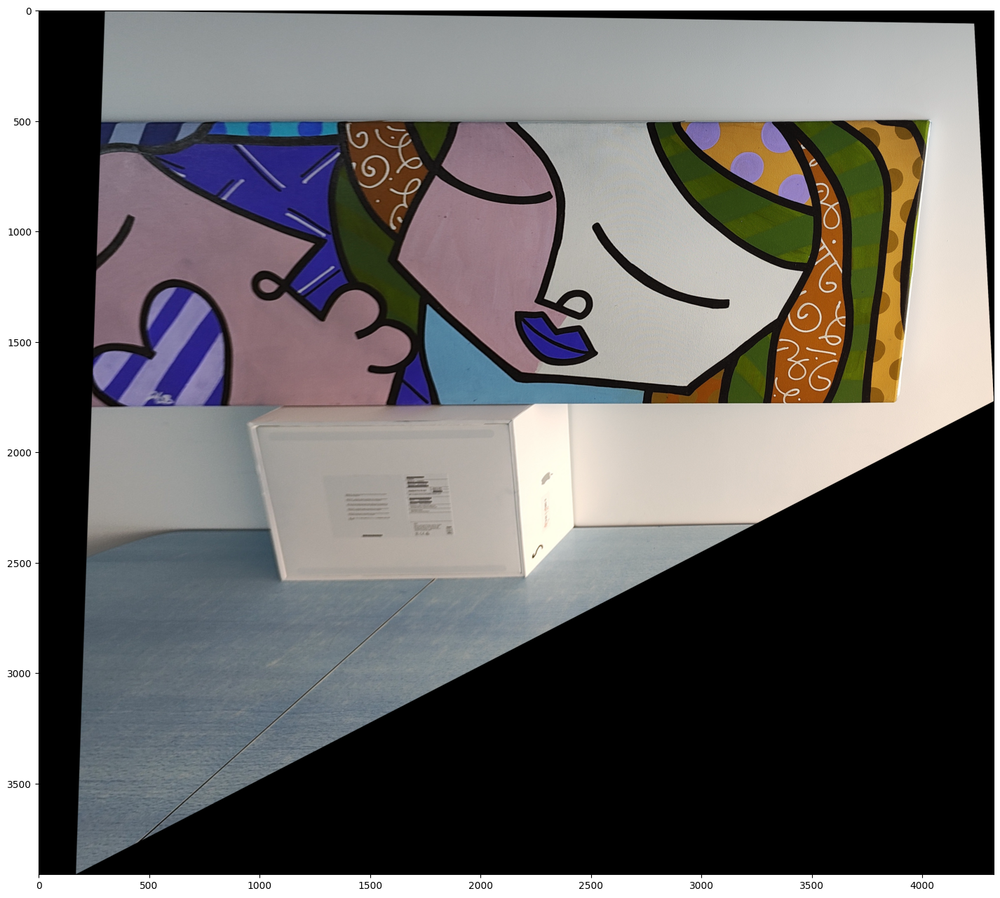

In [ ]:
shift_x_d = round(match_shift_d[0])
shift_y_d = round(match_shift_d[1])
traslated = translate_image(warped_image_d, shift_x_d, 0)
plt.figure(figsize=(20, 16))
plt.imshow(traslated)
plt.show()

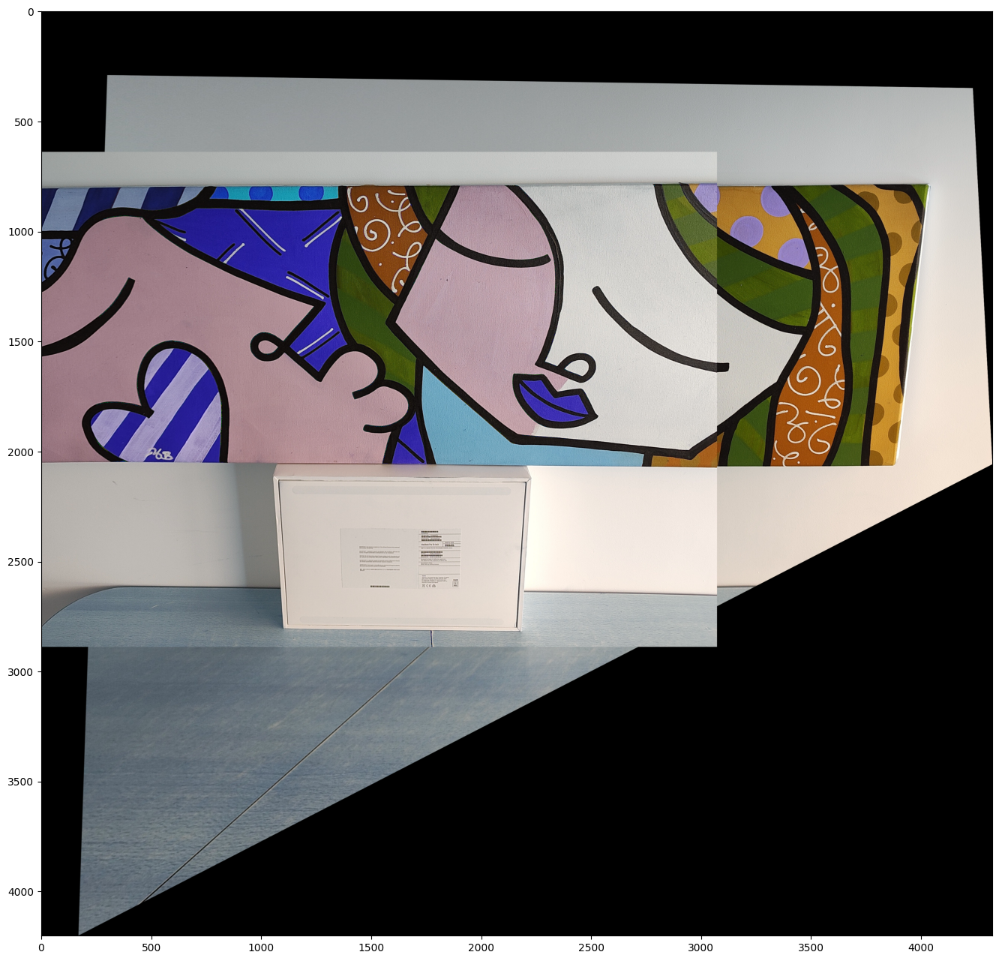

In [ ]:
traslated_b = translate_image(img_ctr_color, 0, shift_y_d)

mixed_1 = overlap_images(traslated_b, traslated)
traslated_c = translate_image(mixed_1, 0, 290)
plt.figure(figsize=(20, 16))
plt.imshow(traslated_c)
plt.show()

Shift en x:  1384
Shift en y:  349


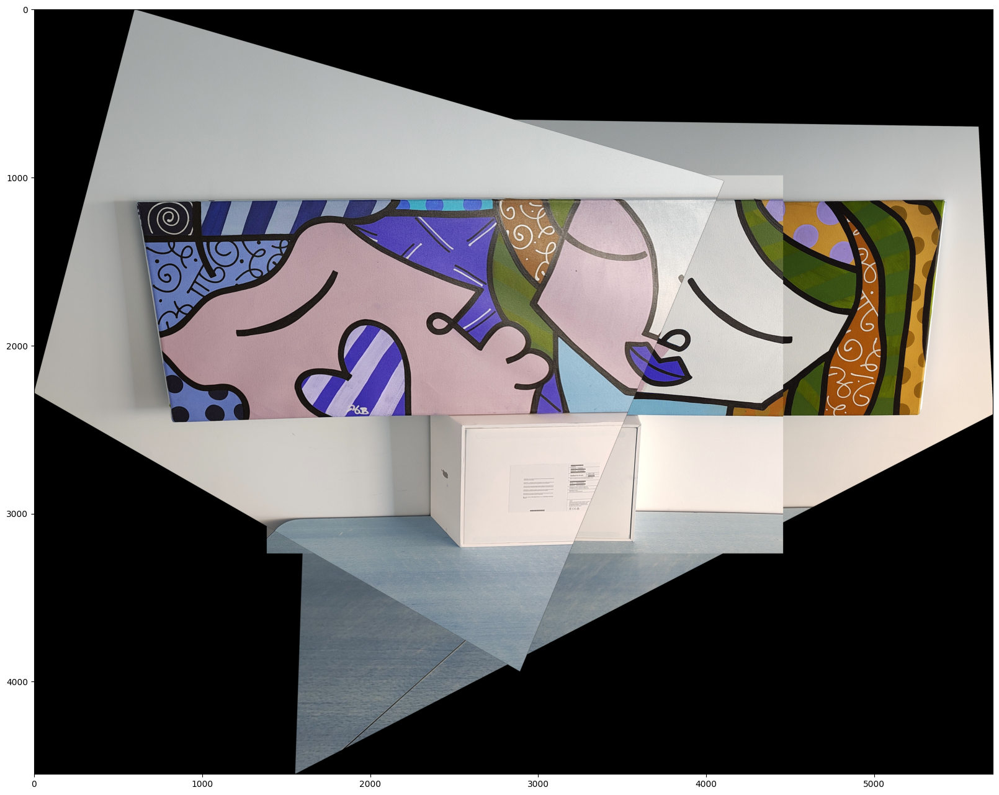

In [ ]:
shift_x_i = round(match_shift_i[0])
shift_y_i = round(match_shift_d[1])
print("Shift en x: ", shift_x_i)
print("Shift en y: ", shift_y_i)
traslated_2 = translate_image(traslated_c, shift_x_i, shift_y_i)
traslated_4 = overlap_images(warped_image_i, traslated_2)

plt.figure(figsize=(20, 16))
plt.imshow(traslated_4)
plt.show()

In [ ]:
# Guardar imagen
#cv2.imwrite(root_path +'/final_image.jpg', traslated_4)

# Stitching con OpenCV

In [ ]:
# Function to perform image stitching
def stitch_images(images):
    # Initialize OpenCV's stitcher object
    stitcher = cv2.Stitcher_create()

    # Perform stitching
    status, stitched_image = stitcher.stitch(images)

    # Check if the stitching was successful
    if status == cv2.Stitcher_OK:
        print("Stitching successful.")
        return stitched_image
    else:
        print("Stitching failed with status code:", status)
        return None

Stitching successful.


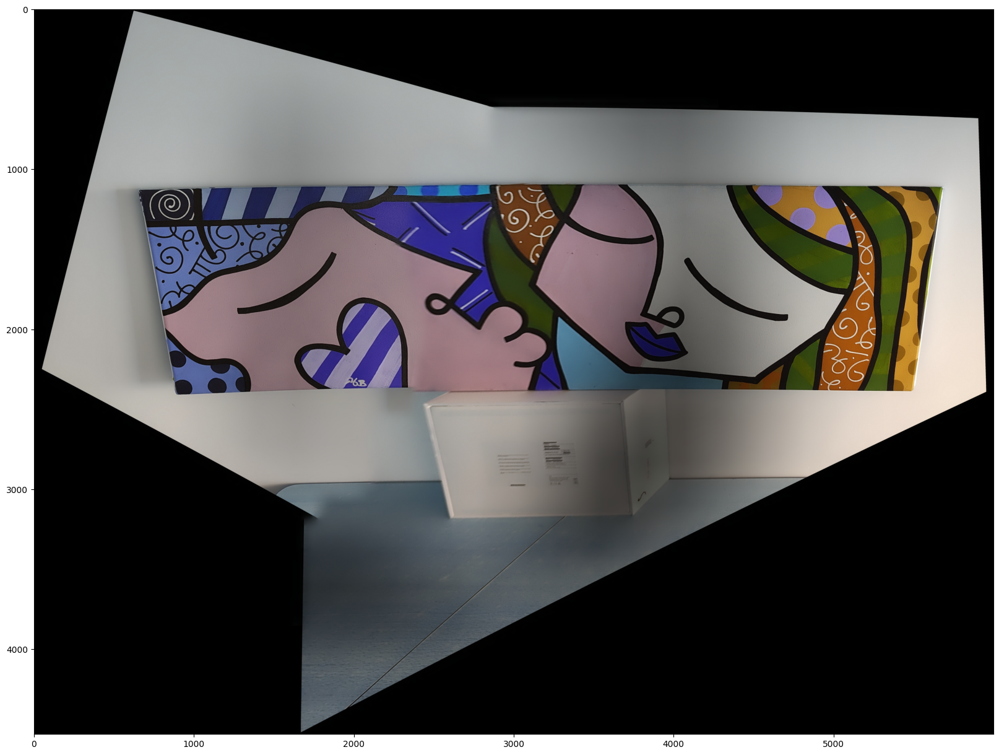

In [ ]:
# Load the images (the images should overlap for better results)
image_1 = img_ctr_color
image_2 = warped_image_d
image_3 = warped_image_i

# Combine the images into a list
images = [image_1, image_2, image_3]

# Perform stitching
stitched_image = stitch_images(images)

# Display the stitched image
if stitched_image is not None:
    plt.figure(figsize=(20, 16))
    plt.imshow(stitched_image)
    plt.show()

    # Optionally, save the result
    cv2.imwrite(root_path +'/stitched_output.jpg', stitched_image)
else:
    print("Stitching was unsuccessful.")


# Generación de imagen panorámica de UDESA

In [ ]:
# Guardar las imágenes en variables
edi_lft = cv2.imread(root_path + '/edificio_izquierda.jpg', cv2.IMREAD_GRAYSCALE)
edi_ctr = cv2.imread(root_path + '/edificio_centro.jpg', cv2.IMREAD_GRAYSCALE)

In [ ]:
#Inicializar SIFT con máx num features porque ANMS tarda demasiado en procesar todos los keypoints (+10hs)
algo= cv2.SIFT_create(nfeatures = 1000)

In [ ]:
#Izquierda
kp_izquierda, desc_izquierda = algo.detectAndCompute(edi_lft, None)
print("kps cuadro izquierda", len(kp_izquierda), "descriptores edificio izquierda", len(desc_izquierda))

# Centro
kp_centro, desc_centro = algo.detectAndCompute(edi_ctr, None)
print("kps cuadro centro", len(kp_centro), "descriptores cuadro centro", len(desc_centro))

kps cuadro izquierda 1000 descriptores edificio izquierda 1000
kps cuadro centro 1000 descriptores cuadro centro 1000


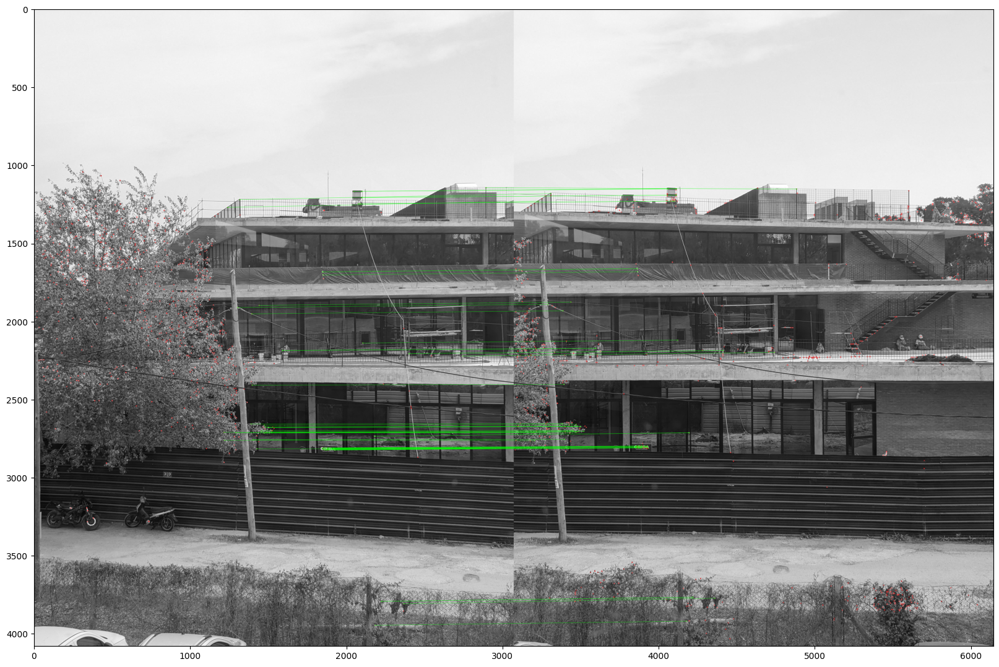

Matches encontrados:  66


In [ ]:
# Brute force matching con Lowe Ratio filtering
matches_i, matchesMask_i = bf_knn_lowe_matcher(desc_izquierda, desc_centro, threshold=0.6)

# Dibuja sólo buenos matches
draw_params = dict(matchColor=(0, 255, 0),
                   singlePointColor=(255, 0, 0),
                   matchesMask=matchesMask_i,
                   flags=cv2.DrawMatchesFlags_DEFAULT)


res_img = cv2.drawMatchesKnn(
    edi_lft, kp_izquierda, edi_ctr, kp_centro, matches_i, None, **draw_params
)

plt.figure(figsize=(20, 16))
plt.imshow(res_img)
plt.show()

# Aplicar máscara a matches para quedarme solo con los buenos
matches_i = [m[0] for m, mask in zip(matches_i, matchesMask_i) if mask[0] == 1]
print("Matches encontrados: ",len(matches_i))

In [ ]:
edi_lft_color = cv2.imread(root_path + '/edificio_izquierda.jpg', cv2.IMREAD_COLOR)
edi_ctr_color = cv2.imread(root_path + '/edificio_centro.jpg', cv2.IMREAD_COLOR)

In [ ]:
# Computar homografía
H_i, mask_i = compute_homography(kp_izquierda, kp_centro, matches_i, ransac_threshold=15)

# Obtener pares de puntos matcheados luego de RANSAC
matches_left_i, matches_right_i = get_matched_points(matches_i, mask_i, kp_izquierda, kp_centro)
print("Pares de puntos matcheados luego de RANSAC: ", len(matches_left_i))

Pares de puntos matcheados luego de RANSAC:  62


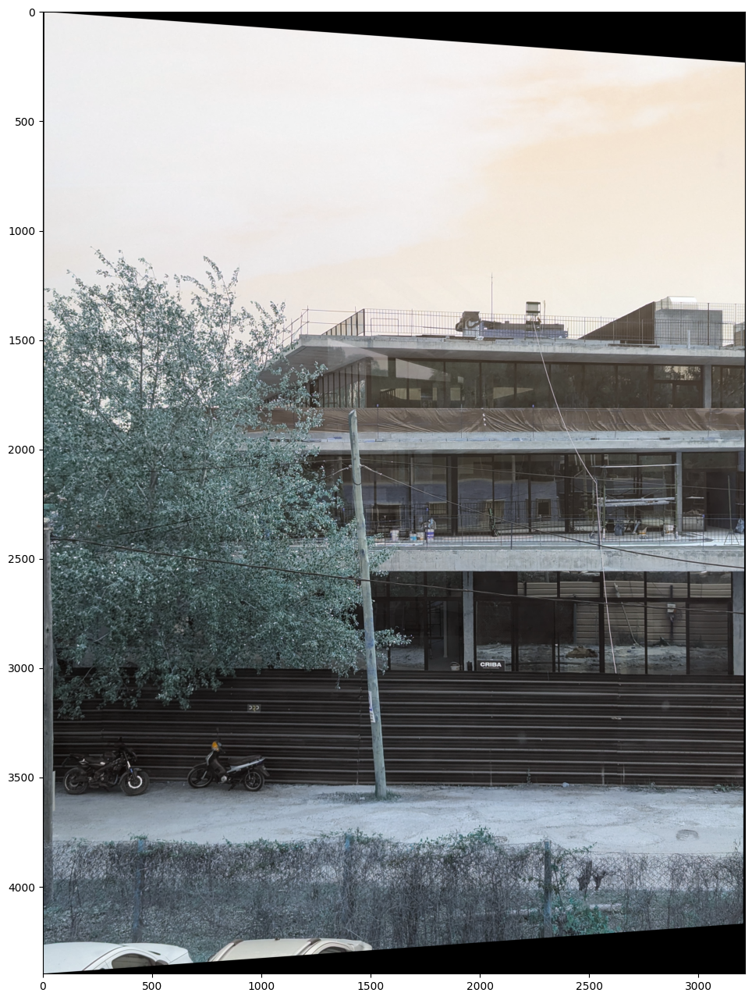

[1228.84824747  179.42215117]


In [ ]:
warped_image_i, transformed_corners_i, match_shift_i = warp_full_image(edi_lft_color, H_i, matches_left_i[0], matches_right_i[0])
# Display the result
plt.figure(figsize=(20, 16))
plt.imshow(warped_image_i)
plt.show()
print(match_shift_i)

kps cuadro derecha 1000 descriptores cuadro derecha 1000


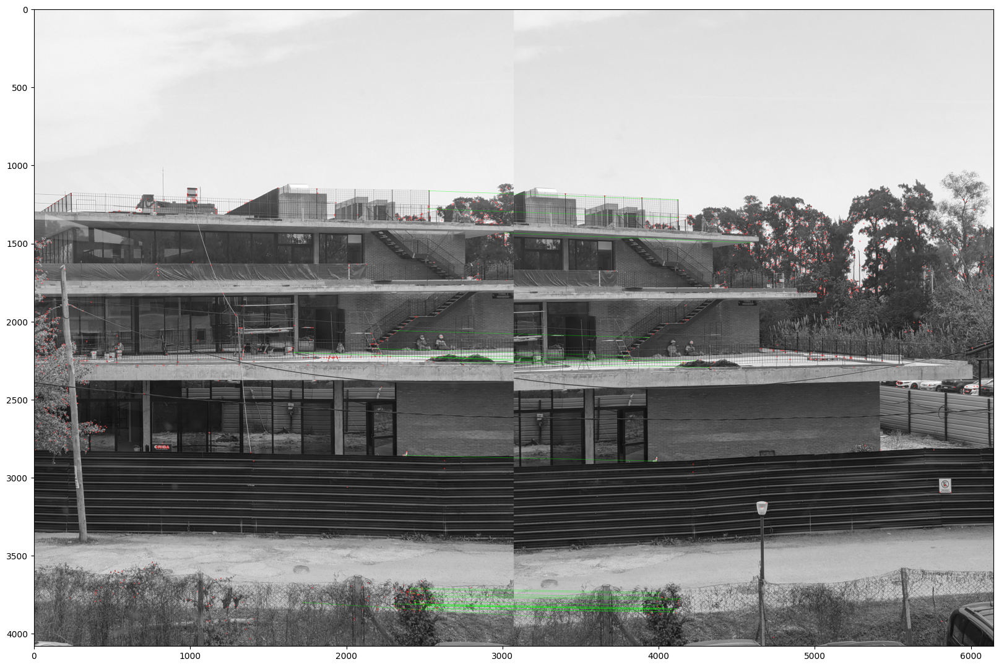

Matches encontrados:  28


In [ ]:
# Cargamos imagen derecha
edi_der = cv2.imread(root_path + '/edificio_derecha.jpg', cv2.IMREAD_GRAYSCALE)
edi_der_color = cv2.imread(root_path + '/edificio_derecha.jpg', cv2.IMREAD_COLOR)

# Sift para extraer keypoints y descriptores de la imagen derecha
algo_der = cv2.SIFT_create(nfeatures = 1000) # Sift optimizado para la imagen derecha

# Derecha
kp_der, desc_der = algo_der.detectAndCompute(edi_der, None)
print("kps cuadro derecha", len(kp_der), "descriptores cuadro derecha", len(desc_der))

# BF matching con Lowe Ratio filtering para imagen central y derecha
# Para este matching se usaron los kp y descriptores de la imagen central y derecha obtenidos con SIFT, sin ANMS ni max local

matches_d, matchesMask_d = bf_knn_lowe_matcher(desc_centro, desc_der, threshold=0.5)

# Dibuja sólo buenos matches
draw_params = dict(matchColor=(0, 255, 0),
                   singlePointColor=(255, 0, 0),
                   matchesMask=matchesMask_d,
                   flags=cv2.DrawMatchesFlags_DEFAULT)


res_img = cv2.drawMatchesKnn(
    edi_ctr, kp_centro, edi_der, kp_der, matches_d, None, **draw_params
)

plt.figure(figsize=(20, 16))
plt.imshow(res_img)
plt.show()

# Aplicar máscara a matches para quedarme solo con los buenos
matches_d = [m[0] for m, mask in zip(matches_d, matchesMask_d) if mask[0] == 1]
print("Matches encontrados: ",len(matches_d))

In [ ]:
# Computar homografía
H_d, mask_d= compute_homography(kp_centro, kp_der, matches_d)

# Obtener pares de puntos matcheados luego de RANSAC
matches_left_d, matches_right_d = get_matched_points(matches_d, mask_d, kp_centro, kp_der)
print("Pares de puntos matcheados luego de RANSAC: ", len(matches_left_d))

Pares de puntos matcheados luego de RANSAC:  23


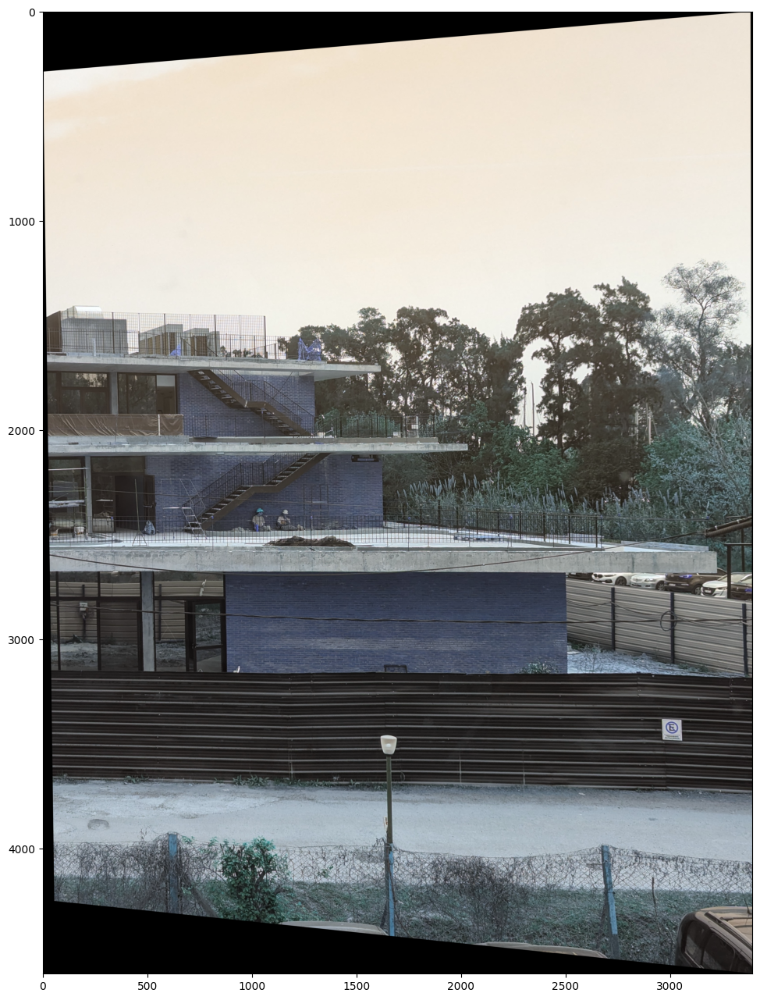

In [ ]:
# Calculamos la inversa de la homografía para transformar imagen de la derecha a la perspectiva de la del centro
H_inv = np.linalg.inv(H_d)

# Aplicar homografía inversa
warped_image_d, transformed_corners_d, match_shift_d = warp_full_image(edi_der_color, H_inv, matches_right_d[0], matches_left_d[0])
# Display the result
plt.figure(figsize=(20, 16))
plt.imshow(warped_image_d)
plt.show()

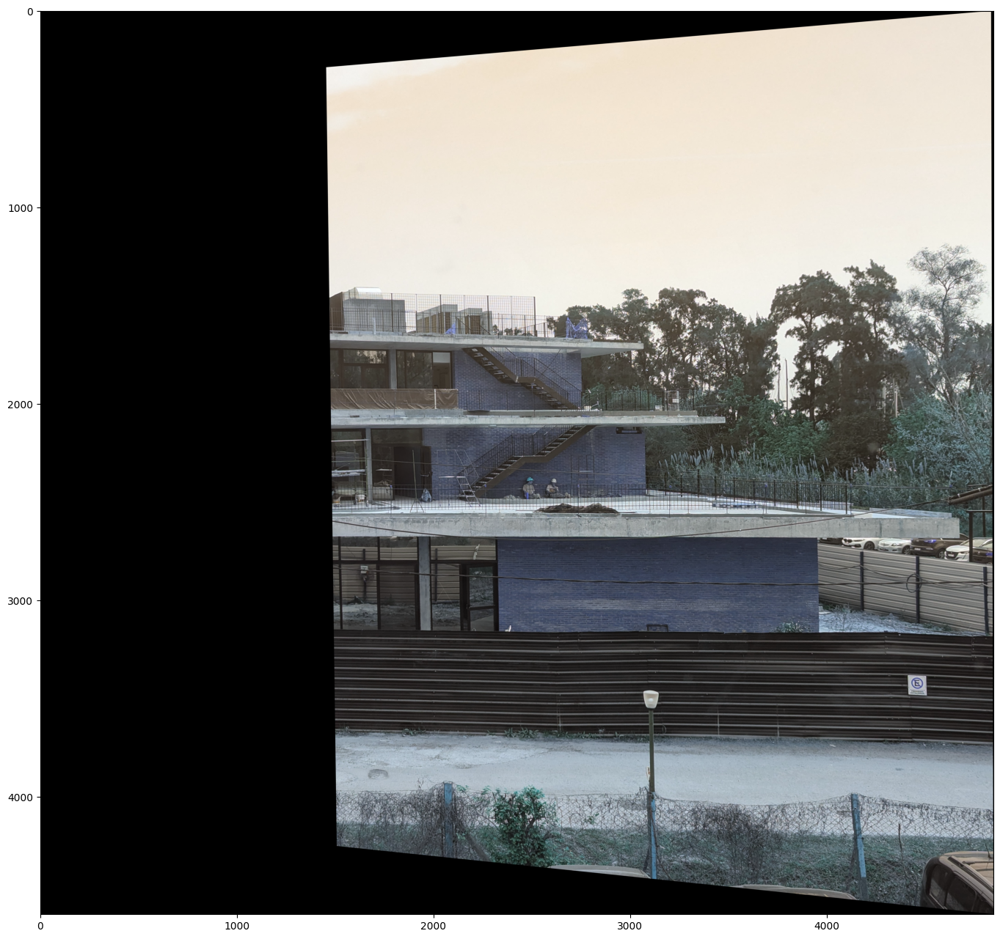

In [ ]:
shift_x_d = round(match_shift_d[0])
shift_y_d = round(match_shift_d[1])
traslated = translate_image(warped_image_d, shift_x_d, 0)
plt.figure(figsize=(20, 16))
plt.imshow(traslated)
plt.show()

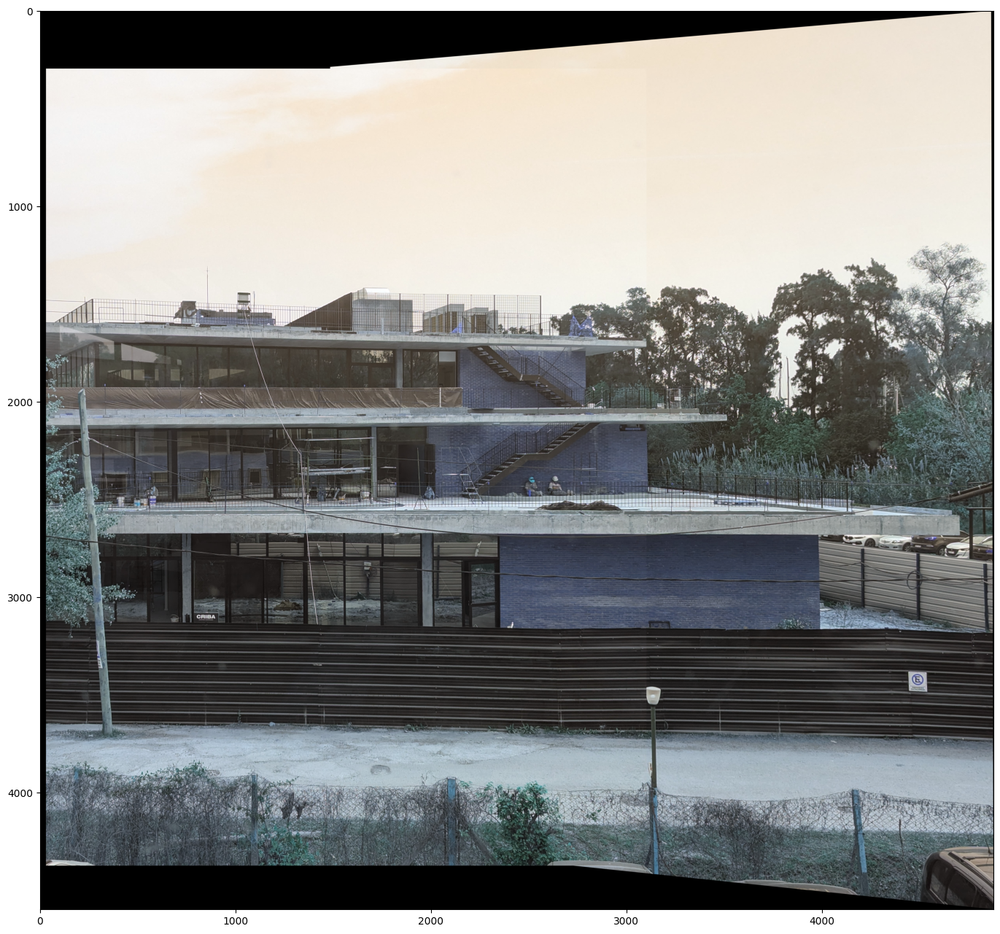

In [ ]:
traslated_b = translate_image(edi_ctr_color, 0, shift_y_d)

mixed_1 = overlap_images(traslated_b, traslated)
traslated_c = translate_image(mixed_1, 30, 0)
plt.figure(figsize=(20, 16))
plt.imshow(traslated_c)
plt.show()

Shift en x:  1229
Shift en y:  295


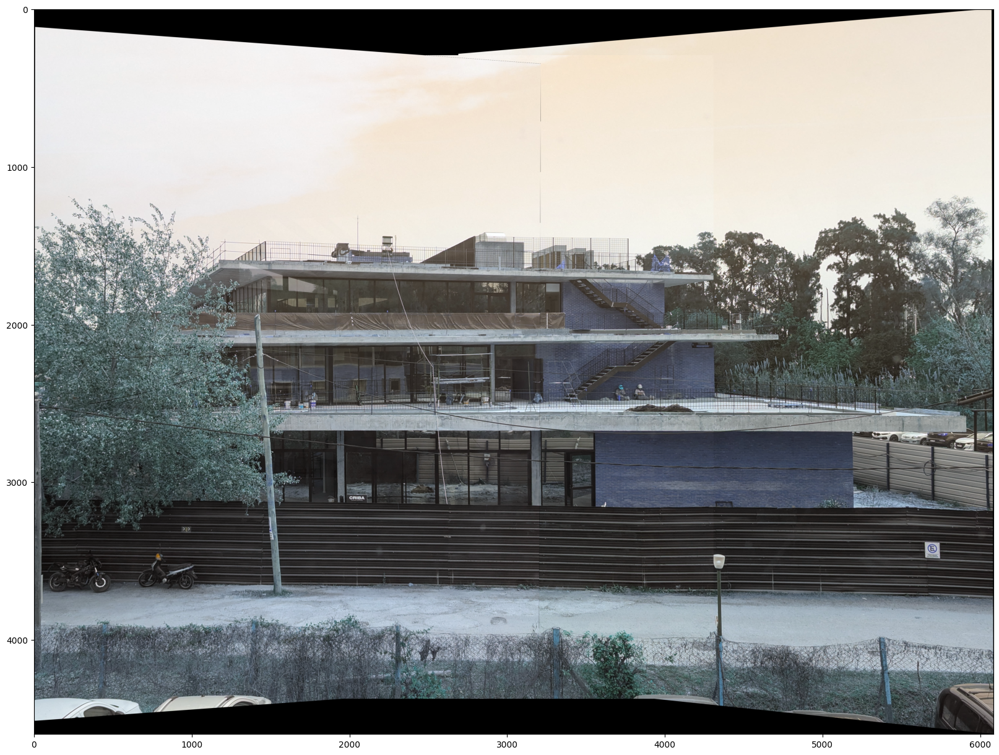

In [ ]:
shift_x_i = round(match_shift_i[0])
shift_y_i = round(match_shift_d[1])
print("Shift en x: ", shift_x_i)
print("Shift en y: ", shift_y_i)
traslated_2 = translate_image(traslated_c, shift_x_i-22, 0)
traslated_3 = translate_image(warped_image_i, 0, 116)
traslated_4 = overlap_images(traslated_3, traslated_2)

plt.figure(figsize=(20, 16))
plt.imshow(traslated_4)
plt.show()

In [ ]:
cv2.imwrite(root_path + '/casera_edificio.jpg', traslated_4)

True

Stitching successful.


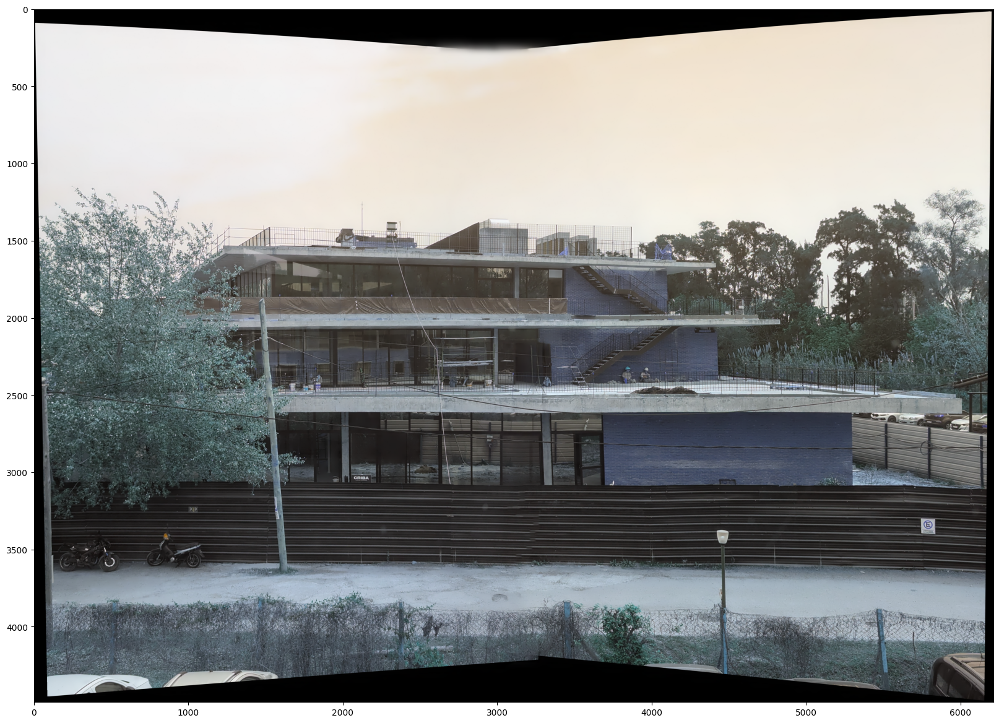

In [ ]:
# Load the images (the images should overlap for better results)
image_1 = edi_ctr_color
image_2 = warped_image_d
image_3 = warped_image_i

# Combine the images into a list
images = [image_1, image_2, image_3]

# Perform stitching
stitched_image = stitch_images(images)

# Display the stitched image
if stitched_image is not None:
    plt.figure(figsize=(20, 16))
    plt.imshow(stitched_image)
    plt.show()

    # Optionally, save the result
    cv2.imwrite(root_path + '/stitched_edificio.jpg', stitched_image)
else:
    print("Stitching was unsuccessful.")